<center><h1>In your face:<br>Biased judgement of fear-anger expressions in violence offenders.</h1></center>

# 5. Fitting Functions

In [1]:
import numpy as np

from scipy import stats
from scipy.special import erf
from scipy.optimize import curve_fit
from scipy.optimize import leastsq

from sklearn.linear_model import LogisticRegression
from sklearn import metrics

import pandas as pd
pd.set_option('max_columns', 100)
pd.set_option('max_rows', 1000)

import os
import fnmatch

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

from myBasics import *

## Defining psychometric functions and plotting some examples

Here, we define a logistic psychometric function and first show some examples how it looks like.  Later, we fit the function to single participant data and extract the parameters (threshold,slope,guess,lapse) that best describe it. These parameters can be used to reconstruct the functions for each participant and they can be used for other computations, like e.g. comparing thresholds between groups.

Dummy x-scale for plotting:

In [2]:
x = np.linspace(0,1,1000)

### Logistic Function:  

$F_{L}(x;{\alpha},{\beta})=\dfrac{1}{1+exp(- {\beta}(x-{\alpha}))}$
  ; or with guess and lapse parameters: 
$F_{L}(x;{\alpha},{\beta},{\gamma},{\lambda})=\gamma + (1 - \gamma - \lambda)*\dfrac{1}{1+exp(- {\beta}(x-{\alpha}))}$

In [3]:
# adapted for Python from the Palamedes Toolbox by Nicolaas Prins and Frederick Kingdom (PAL_Logistic.m)
# Prins, N & Kingdom, F. A. A. (2009) Palamedes:  Matlab routines for analyzing psychophysical data.
# http://www.palamedestoolbox.org

def logisticFunction(x,threshold,slope,guess,lapse):
    return guess + (1. - guess - lapse)*(1./(1.+np.exp(-slope*(x-threshold))))

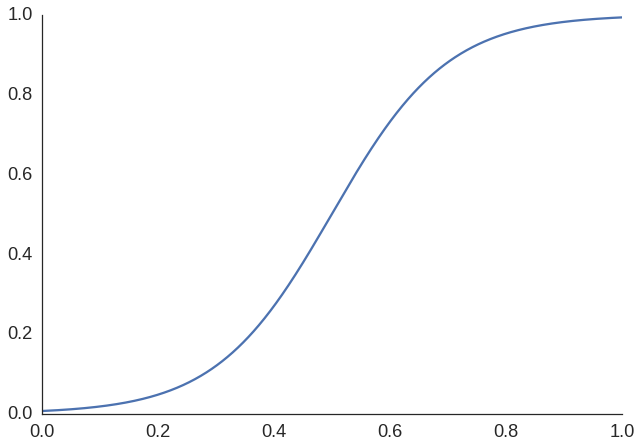

In [4]:
plt.plot(x,logisticFunction(x,0.5,10,0,0));
sns.despine()

### Interactive plot to see the effects of wiggling each parameter

In [5]:
# Interactive plots for static html notebooks; using ipywidgets by Jake Vanderplas  
# https://github.com/jakevdp/ipywidgets-static

from ipywidgets_static import StaticInteract, RangeWidget, RadioWidget

In [6]:
def iPlot(thresh,slope,guess,lapse):
    
    # make x-axis fine-grained
    x = np.linspace(0, 1, 1000)
    
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.plot(x, logisticFunction(x,thresh,slope,guess,lapse),
            lw=5, alpha=0.8)

    ax.set_xlim(0,1)
    ax.set_ylim(0,1)
    
    thisEquation = '$F_{L}=%s + (1 - %s - %s)*\\frac{1}{1+exp(- {%s}(x-{%s}))}$' %(guess,guess,lapse,slope,thresh)
    
    ax.text(1.1, 0.5, thisEquation, fontsize=25)
    sns.despine()
    return fig

In [7]:
StaticInteract(iPlot,
               thresh=RangeWidget(.2, 0.8, 0.1),
               slope=RangeWidget(10, 20, 2),
               guess=RangeWidget(.0, .2, 0.1),
               lapse=RangeWidget(.0, .2, 0.1),
              )

/opt/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


## Fitting Functions:

In [8]:
# taken from: Ariel Rokem;
# https://github.com/arokem/teach_optimization/blob/master/optimization.ipynb
def err_func(params, x, y, func):
        return y - func(x, *params)

In [9]:
def getFit(x,y,func,initalGuesses):
    params, _ = leastsq(err_func,
                        initalGuesses,
                        args=(x, y, func),
                        maxfev=1000000000 # a high number, for safety
                       )
    return params

### Apply functions to data:

In [10]:
df = pd.read_csv('../outputs/genderTable.csv',
                 index_col=[0,1,2])

df = df[df.columns[:-1]]

In [11]:
df.tail()

00    01    02    03    04    05    06    07    08    09  \
g p    fgender                                                               
K K013 M        0.25  0.50  0.40  0.55  0.60  0.55  0.80  0.80  1.00  0.90   
  K014 F        0.00  0.00  0.05  0.00  0.00  0.25  0.45  0.70  0.85  0.95   
       M        0.20  0.20  0.30  0.35  0.35  0.40  0.45  0.65  0.75  0.90   
  K015 F        0.10  0.15  0.20  0.20  0.30  0.45  0.70  0.75  0.90  1.00   
       M        0.00  0.00  0.05  0.20  0.35  0.30  0.65  0.70  0.85  1.00   

                  10  
g p    fgender        
K K013 M        1.00  
  K014 F        0.95  
       M        0.85  
  K015 F        0.95  
       M        1.00

parameters need to be initalized. Here, we set them as following:  
- threshold: 0.5 (steepest point at 50%)
- slope: 5 (not equivalent with the first derivative; instad the meaning will differ for each function)
- guessing: 0 (assuming no guessing)
- lapses: 0 (assuming no lapses)

In [12]:
initalGuesses = 0.5,5,0,0

### Example fitting with mean over all control participants:

In [13]:
y = np.array( df.ix['A'].mean() )
x = np.linspace(0,1,len(y))

In [14]:
params = getFit(x,y,logisticFunction,initalGuesses)

In [15]:
params

array([ 0.55462598,  7.4084308 ,  0.09465109,  0.08281134])

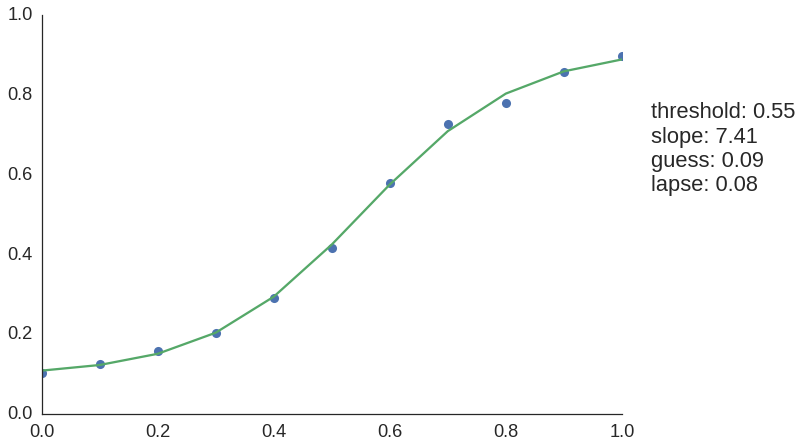

In [16]:
plt.ylim(0,1)
plt.plot( x, y, 'o' )
params = getFit(x,y,logisticFunction,initalGuesses)
plt.plot( x, logisticFunction( x, *params ) )
plt.text(1.05, 0.5, 
         'threshold: %s\nslope: %s\nguess: %s\nlapse: %s\n' 
         % (round(params[0],2),round(params[1],2),round(params[2],2),round(params[3],2)) 
        )
sns.despine()
plt.show()

## Interactive plot, to inspect the fitted function for each participant!

In [17]:
def makeSinglePlot(groupName,participant):

    if groupName == "violence offenders":
        group = 'G'
    elif groupName == "child molesters":
        group = 'K' 
    elif groupName == "general population":
        group = 'A' 
        
    fig = plt.figure(figsize=(16, 6))
    
    myCol = myPal[labelCoding[group]]
    
    for i,fGender in enumerate(['M','F']):
        ax = plt.subplot(1,2,i+1)
        try: 
            #select a participant
            thisGroup= group
            groupEntries = [ n for n,x in enumerate( df.index.levels[1] ) if x[0]==thisGroup ] 
            p = df.index.levels[1][groupEntries[participant]]

            # get the data and transform to numpy array
            y = np.array( df.ix[p[0]].ix[p].ix[fGender] )
            x = np.linspace(0,1,len(y))

            # plot the raw data
            ax.plot( x, y,
                        'o',markersize=12, markeredgecolor='grey',markerfacecolor=myCol )
            # plot the fitted data
            params = getFit(x,y,logisticFunction,initalGuesses)
            ax.plot( x, logisticFunction( x, *params ),
                         linewidth=8, alpha=0.6, color=myCol)
            ax.text(.6, .1, 
                             'threshold: %s\nslope: %s\nguess: %s\nlapse: %s\n' 
                             % (round(params[0],2),round(params[1],2),round(params[2],2),round(params[3],2)) 
                            )
            ax.set_xlim(0,1)
            ax.set_ylim(0,1)

            ax.set_title(fGender)

            plt.suptitle(p,fontsize=20)
            sns.despine()
        except:

            ax.set_xlim(0,1)
            ax.set_ylim(0,1)

            ax.set_title('no data')

            plt.suptitle('no data',fontsize=20)
            sns.despine()
        
    return fig   

In [18]:
StaticInteract(makeSinglePlot,
               groupName=RadioWidget(['violence offenders','child molesters','general population']),
               participant=RangeWidget(0, 29, 1)
              )

## Get curve parameters

In [19]:
def makeParamsDict(df):
    # dict to write to
    d = {}
    
    # loop through group
    for group in df.index.levels[0]:
        # loop through participants of that group
        for p in df.ix[group].index.levels[0]:
            if p[0] == group:
                # loop through face gender
                for fgender in df.ix[group].ix[p].index:
                    
                    # get the data
                    y = np.array( df.ix[group].ix[p].ix[fgender] )
                    x = np.linspace(0,1,len(y))

                    # get parameters from fitting
                    threshold,slope,guess,lapse = getFit(x,y,logisticFunction,initalGuesses)
                    
                    # either fill dict entry or make the entry and fill then
                    try:
                        d[p][fgender] = {'threshold':threshold,
                                'slope':slope,
                                'guess':guess,
                                'lapse':lapse
                               }
                    except:
                        d[p] = { 'F':{}, 'M':{} }
                        d[p][fgender] = {'threshold':threshold,
                                         'slope':slope,
                                         'guess':guess,
                                         'lapse':lapse
                                         }
    # output is the dict
    return d

In [20]:
def makeParamsDf(d):
    # empty dict to write to
    paramsDf = pd.DataFrame()
    # loop through dict
    for entry in d:
        # make a table out of the data of one participant
        thisDf = pd.DataFrame(d[entry])
        thisDf.index = [ [entry]*len(thisDf),thisDf.index]
        # reshape, so that results are all in one row
        thisDf = thisDf.unstack()
        # append to big df
        paramsDf = pd.concat([paramsDf,thisDf])
    # making index nice
    paramsDf = paramsDf.sort_index()
    paramsDf.index = [ [name[0] for name in paramsDf.index ], paramsDf.index ]
    
    return paramsDf

We get a table with all four curve parameters for each participant and each face type (female,male). These data can be compared between groups or used to reconstruct the respective logistic function.

In [21]:
paramsDf = makeParamsDf(makeParamsDict(df))

In [22]:
paramsDf.head()

F                                        M            \
           guess     lapse      slope threshold     guess     lapse   
A A001  0.106096  0.045968  30.023075  0.538619  0.060214 -0.032920   
  A002  0.128144  0.050533  11.404248  0.515501  0.141569 -0.056500   
  A003 -0.041611  0.187950   5.700279  0.485627 -0.037189 -0.202456   
  A004  0.403708  0.180693  17.472763  0.907479  0.356250  0.500000   
  A005  0.262098 -0.017575  11.898831  0.471887  0.230314 -0.026271   

                              
             slope threshold  
A A001    8.437888  0.527474  
  A002    6.744358  0.556187  
  A003    5.246829  0.693392  
  A004  197.740393  0.796821  
  A005   10.781355  0.476161

### Spaghetti plots of fitted functions

In [23]:
def makeGenderSpaghetti(paramsDf,cond,count):
    
    # resolution of fitted data
    x = np.linspace(0,1,1000)
    
    ax = plt.subplot(3,2,count)
    
    # to loop through all cases but have only one legend without redundancies,
    # here we keep track of whether a condition is already labeled
    legTrack = []
    
    # looping  through the 3 groups
    for group in paramsDf.index.levels[0]:
        # looping through the participants of each group
        for p in paramsDf.ix[group].index:
            if p[0] in group:
                
                # color and legend setting for that group
                thisCol = myPal[labelCoding[p[0]]]
                thisLeg = myGLabels[p[0]]
                
                # get the data from the specified row
                theseParams = paramsDf.ix[group].ix[p].ix[cond]
                
                t = theseParams['threshold']
                s = theseParams['slope']
                g = theseParams['guess']
                l = theseParams['lapse']

                thisList = logisticFunction( x, t,s,g,l )

                # plotting with legend if this is the first instance,
                # otherwise plot without a legend
                if thisLeg not in legTrack:
                    ax.plot(thisList,
                            c=thisCol,
                            alpha=0.4,
                            linewidth=3,
                            label=thisLeg)
                else:
                    ax.plot(thisList,
                            c=thisCol,
                            linewidth=3,
                            alpha=0.4)            
                # keep track which conditions already have a legend
                legTrack.append(thisLeg)
        
    # plot formatting
    ax.set_xlabel('Morphing Grade (Fear --> Anger)')
    ax.set_ylabel('% Anger Responses')

    plt.xticks(np.arange(0,1001,200), [str(a)+'%' for a in  np.arange(0,101,20)])
    plt.yticks(np.arange(0,1.01,0.2), [str(a)+'%' for a in  np.arange(0,101,20)])

    plt.ylim(-0.02,1.02); plt.xlim(-0.1,1001)
    if cond == 'M':
        ax.set_title('Male Faces')
    elif cond == 'F':
        ax.set_title('Female Faces')
        # one legend for both plots
        plt.legend(loc='best',bbox_to_anchor=[1, 1])

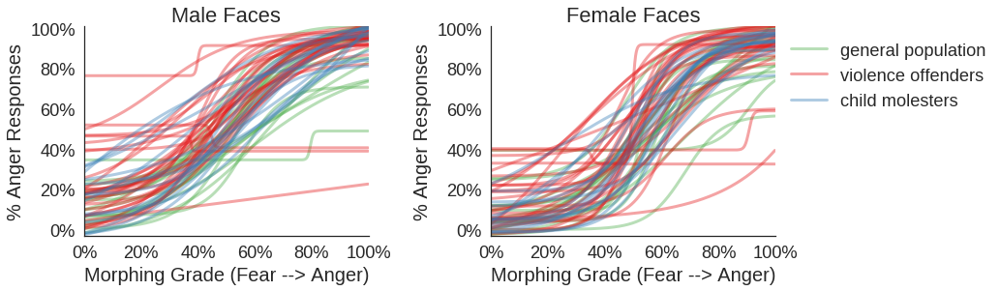

In [24]:
plt.figure(figsize=(12,12))
for i,fgender in enumerate(['M','F']):
    makeGenderSpaghetti(paramsDf,fgender,i+1)
sns.despine()
plt.tight_layout()
plt.show()

### eliminate data for which fitting is not possible

In [25]:
eliminated = ['G002','G011','G013','G016','G025','K003','K004','A004']
    

In [26]:
def showEliminated(paramsDf,eliminated):
    
    fig = plt.figure(figsize=(16,6))

    for e,elim in enumerate(eliminated):

        thisDf = paramsDf.ix[elim[0]].ix[elim].ix['M']
        guess = thisDf.ix['guess']
        lapse = thisDf.ix['lapse']
        slope = thisDf.ix['slope']
        threshold = thisDf.ix['threshold']

        ax = plt.subplot(2,len(eliminated),e+1)
        ax.plot( logisticFunction(x,threshold,slope,guess,lapse) )    

        ax.set_title(elim+' M')
        ax.set_ylim(0,1)

    for e,elim in enumerate(eliminated):

        thisDf = paramsDf.ix[elim[0]].ix[elim].ix['F']
        guess = thisDf.ix['guess']
        lapse = thisDf.ix['lapse']
        slope = thisDf.ix['slope']
        threshold = thisDf.ix['threshold']

        ax = plt.subplot(2,len(eliminated),len(eliminated)+e+1)
        ax.plot( logisticFunction(x,threshold,slope,guess,lapse) )

        ax.set_title(elim+' F')
        ax.set_ylim(0,1)
    
        sns.despine()
        
    plt.tight_layout()
    
    plt.show()


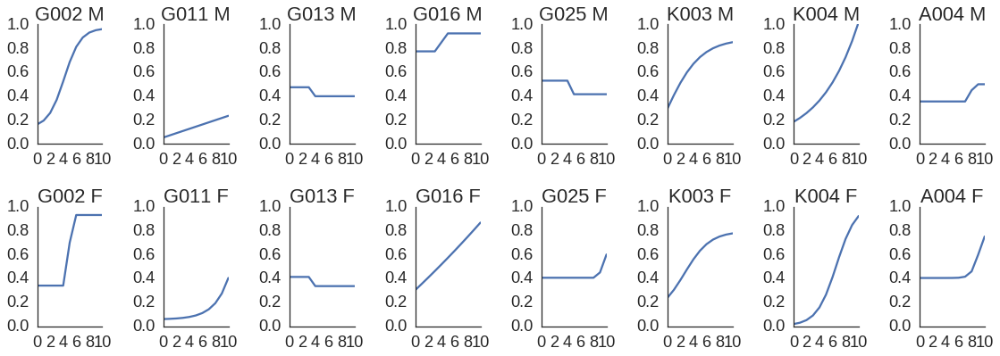

In [27]:
showEliminated(paramsDf,eliminated)

In [28]:
for elim in eliminated:
    paramsDf.drop([elim],level=1, inplace=True)

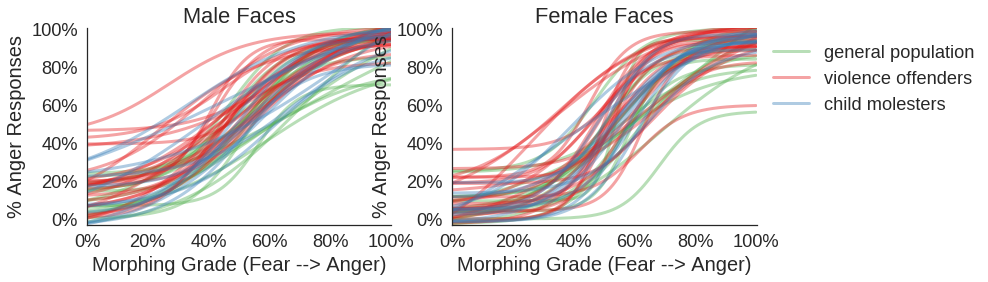

In [29]:
plt.figure(figsize=(12,12))
for i,fgender in enumerate(['M','F']):
    makeGenderSpaghetti(paramsDf,fgender,i+1)
    sns.despine()
plt.show()

### save  cleaned-up as  csv

In [30]:
paramsDf.to_csv('../outputs/paramsTable.csv')

### Plott averaged fitted functions

In [31]:
def makeFittedValuesDf(paramsDf,fGender):
    
    funcDf = pd.DataFrame()
    for i,group in enumerate( paramsDf.index.levels[0] ):
        for p in paramsDf.index.levels[1]:
            # we need a try/except here, because some participants might have been 
            # removed from the df (but are still in the non-updated index...)
            try:
                if group in p:

                    # choose the parameters of one participant
                    thisDf = paramsDf.ix[p[0]].ix[p].ix[fGender]
                    guess = thisDf.ix['guess']
                    lapse = thisDf.ix['lapse']
                    slope = thisDf.ix['slope']
                    threshold = thisDf.ix['threshold']

                    # get the data
                    yFunc = logisticFunction(np.linspace(0,1,1001),threshold,slope,guess,lapse) 
                    thisDf = pd.DataFrame(yFunc).T
                    thisDf.index = [[group],[p]]
                    funcDf = pd.concat([funcDf,thisDf])

            except:
                print "...participant %s excluded" % p
                
    return funcDf

This is a large df, which stores not the raw data of the 11 original steps, but the fitted logistic function's y-values in a 1/1000 resolution.

In [32]:
funcDf = makeFittedValuesDf(paramsDf,'M')

...participant A004 excluded
...participant G002 excluded
...participant G011 excluded
...participant G013 excluded
...participant G016 excluded
...participant G025 excluded
...participant K003 excluded
...participant K004 excluded


In [33]:
funcDf.head()

0         1         2         3         4         5         6     \
A A001  0.071434  0.071528  0.071623  0.071718  0.071815  0.071912  0.072010   
  A002  0.162568  0.162707  0.162847  0.162988  0.163129  0.163272  0.163415   
  A003 -0.005419 -0.005256 -0.005093 -0.004928 -0.004763 -0.004597 -0.004430   
  A005  0.234979  0.235029  0.235080  0.235131  0.235183  0.235235  0.235288   
  A006  0.252291  0.252324  0.252357  0.252390  0.252424  0.252458  0.252492   

            7         8         9         10        11        12        13    \
A A001  0.072108  0.072208  0.072308  0.072410  0.072512  0.072614  0.072718   
  A002  0.163559  0.163704  0.163851  0.163998  0.164146  0.164295  0.164445   
  A003 -0.004262 -0.004094 -0.003924 -0.003754 -0.003583 -0.003411 -0.003238   
  A005  0.235342  0.235396  0.235451  0.235506  0.235562  0.235619  0.235676   
  A006  0.252527  0.252562  0.252598  0.252634  0.252670  0.252707  0.252744   

            14        15        16        17        18        19        20    \
A A001  0.072823  0.072928  0.073035  0.073142  0.073250  0.073359  0.073469   
  A002  0.164596  0.164747  0.164900  0.165054  0.165209  0.165365  0.165522   
  A003 -0.003064 -0.002890 -0.002714 -0.002538 -0.002361 -0.002183 -0.002004   
  A005  0.235733  0.235792  0.235851  0.235910  0.235970  0.236031  0.236093   
  A006  0.252782  0.252819  0.252858  0.252896  0.252935  0.252975  0.253015   

            21        22        23        24        25        26        27    \
A A001  0.073579  0.073691  0.073804  0.073917  0.074032  0.074147  0.074263   
  A002  0.165679  0.165838  0.165998  0.166159  0.166321  0.166484  0.166648   
  A003 -0.001824 -0.001643 -0.001462 -0.001279 -0.001096 -0.000911 -0.000726   
  A005  0.236155  0.236218  0.236281  0.236346  0.236411  0.236476  0.236542   
  A006  0.253055  0.253096  0.253137  0.253179  0.253221  0.253264  0.253307   

            28        29        30        31        32        33        34    \
A A001  0.074381  0.074499  0.074618  0.074739  0.074860  0.074982  0.075105   
  A002  0.166813  0.166979  0.167146  0.167314  0.167484  0.167654  0.167825   
  A003 -0.000540 -0.000353 -0.000165  0.000024  0.000214  0.000405  0.000596   
  A005  0.236609  0.236677  0.236745  0.236815  0.236884  0.236955  0.237027   
  A006  0.253350  0.253394  0.253438  0.253483  0.253528  0.253574  0.253621   

            35        36        37        38        39        40        41    \
A A001  0.075229  0.075355  0.075481  0.075608  0.075737  0.075866  0.075997   
  A002  0.167998  0.168172  0.168346  0.168522  0.168699  0.168877  0.169057   
  A003  0.000789  0.000983  0.001177  0.001373  0.001569  0.001767  0.001965   
  A005  0.237099  0.237172  0.237245  0.237320  0.237395  0.237471  0.237548   
  A006  0.253667  0.253715  0.253762  0.253811  0.253859  0.253909  0.253959   

            42        43        44        45        46        47        48    \
A A001  0.076128  0.076261  0.076394  0.076529  0.076665  0.076802  0.076940   
  A002  0.169237  0.169418  0.169601  0.169785  0.169970  0.170156  0.170344   
  A003  0.002165  0.002365  0.002566  0.002769  0.002972  0.003177  0.003382   
  A005  0.237626  0.237704  0.237783  0.237864  0.237945  0.238027  0.238109   
  A006  0.254009  0.254060  0.254111  0.254163  0.254216  0.254269  0.254322   

            49      ...         951       952       953       954       955   \
A A001  0.077080    ...     1.006378  1.006595  1.006810  1.007023  1.007235   
  A002  0.170532    ...     0.996840  0.997215  0.997588  0.997958  0.998327   
  A003  0.003588    ...     0.947579  0.948640  0.949697  0.950751  0.951802   
  A005  0.238193    ...     1.021540  1.021591  1.021640  1.021690  1.021739   
  A006  0.254377    ...     0.947198  0.947264  0.947329  0.947394  0.947458   

            956       957       958       959       960       961       962   \
A A001  1.007445  1.007654  1.007861  1.008066  1.008270  1.008471  1.008672   
  A0

Do this for both female and male faces, then concatenate.

In [34]:
def mergeFuncDf(paramsDf):    
    outFunc = pd.DataFrame()
    for fGender in ['M','F']:
        thisFunc = makeFittedValuesDf(paramsDf,fGender)
        thisFunc.columns = [ [fGender]*len(thisFunc.columns), thisFunc.columns ]
        outFunc = pd.concat([outFunc,thisFunc],axis=1)
    return outFunc

In [35]:
logFuncDf = mergeFuncDf(paramsDf)

...participant A004 excluded
...participant G002 excluded
...participant G011 excluded
...participant G013 excluded
...participant G016 excluded
...participant G025 excluded
...participant K003 excluded
...participant K004 excluded
...participant A004 excluded
...participant G002 excluded
...participant G011 excluded
...participant G013 excluded
...participant G016 excluded
...participant G025 excluded
...participant K003 excluded
...participant K004 excluded


In [36]:
logFuncDf.head()

M                                                              \
            0         1         2         3         4         5         6      
A A001  0.071434  0.071528  0.071623  0.071718  0.071815  0.071912  0.072010   
  A002  0.162568  0.162707  0.162847  0.162988  0.163129  0.163272  0.163415   
  A003 -0.005419 -0.005256 -0.005093 -0.004928 -0.004763 -0.004597 -0.004430   
  A005  0.234979  0.235029  0.235080  0.235131  0.235183  0.235235  0.235288   
  A006  0.252291  0.252324  0.252357  0.252390  0.252424  0.252458  0.252492   

                                                                              \
            7         8         9         10        11        12        13     
A A001  0.072108  0.072208  0.072308  0.072410  0.072512  0.072614  0.072718   
  A002  0.163559  0.163704  0.163851  0.163998  0.164146  0.164295  0.164445   
  A003 -0.004262 -0.004094 -0.003924 -0.003754 -0.003583 -0.003411 -0.003238   
  A005  0.235342  0.235396  0.235451  0.235506  0.235562  0.235619  0.235676   
  A006  0.252527  0.252562  0.252598  0.252634  0.252670  0.252707  0.252744   

                                                                              \
            14        15        16        17        18        19        20     
A A001  0.072823  0.072928  0.073035  0.073142  0.073250  0.073359  0.073469   
  A002  0.164596  0.164747  0.164900  0.165054  0.165209  0.165365  0.165522   
  A003 -0.003064 -0.002890 -0.002714 -0.002538 -0.002361 -0.002183 -0.002004   
  A005  0.235733  0.235792  0.235851  0.235910  0.235970  0.236031  0.236093   
  A006  0.252782  0.252819  0.252858  0.252896  0.252935  0.252975  0.253015   

                                                                              \
            21        22        23        24        25        26        27     
A A001  0.073579  0.073691  0.073804  0.073917  0.074032  0.074147  0.074263   
  A002  0.165679  0.165838  0.165998  0.166159  0.166321  0.166484  0.166648   
  A003 -0.001824 -0.001643 -0.001462 -0.001279 -0.001096 -0.000911 -0.000726   
  A005  0.236155  0.236218  0.236281  0.236346  0.236411  0.236476  0.236542   
  A006  0.253055  0.253096  0.253137  0.253179  0.253221  0.253264  0.253307   

                                                                              \
            28        29        30        31        32        33        34     
A A001  0.074381  0.074499  0.074618  0.074739  0.074860  0.074982  0.075105   
  A002  0.166813  0.166979  0.167146  0.167314  0.167484  0.167654  0.167825   
  A003 -0.000540 -0.000353 -0.000165  0.000024  0.000214  0.000405  0.000596   
  A005  0.236609  0.236677  0.236745  0.236815  0.236884  0.236955  0.237027   
  A006  0.253350  0.253394  0.253438  0.253483  0.253528  0.253574  0.253621   

                                                                              \
            35        36        37        38        39        40        41     
A A001  0.075229  0.075355  0.075481  0.075608  0.075737  0.075866  0.075997   
  A002  0.167998  0.168172  0.168346  0.168522  0.168699  0.168877  0.169057   
  A003  0.000789  0.000983  0.001177  0.001373  0.001569  0.001767  0.001965   
  A005  0.237099  0.237172  0.237245  0.237320  0.237395  0.237471  0.237548   
  A006  0.253667  0.253715  0.253762  0.253811  0.253859  0.253909  0.253959   

                                                                              \
            42        43        44        45        46        47        48     
A A001  0.076128  0.076261  0.076394  0.076529  0.076665  0.076802  0.076940   
  A002  0.169237  0.169418  0.169601  0.169785  0.169970  0.170156  0.170344   
  A003  0.002165  0.002365  0.002566  0.002769  0.002972  0.003177  0.003382   
  A005  0.237626  0.237704  0.237783  0.237864  0.237945  0.238027  0.238109   
  A006  0.254009  0.254060  0.254111  0.254163  0.254216  0.254269  0.254322   

                    ...            F                                          \
        

## Plot fitted functions

In [37]:
def plotSmoothFuncs(funcDf,myGroups,numSteps=1001,myMax=1.02,myPal=myPal,myLabels=labelCoding):
    fig = plt.figure(figsize=(16,6))

    
    for j,fGender in enumerate(['M','F']):
        ax = plt.subplot(1,2,j+1)
        # now loop through all groups, including the violence offenders (G)
        for i,group in enumerate(myGroups):

            # get mean value of that group
            meanFunc = funcDf[fGender].ix[group].mean()
            # get standard deviation of that group
            stdFunc = funcDf[fGender].ix[group].std(ddof=1)
            # get group size
            n = len(funcDf[fGender].ix[group])
            # compute 95% confidence interval
            ciFunc = (stdFunc/np.sqrt( n ) )*1.96
            # compute the lower and upper bounds of the CI
            upperBound = meanFunc + ciFunc
            lowerBound = meanFunc - ciFunc
            # plot the mean value
            ax.plot(np.linspace(0,1,numSteps), meanFunc,
                    color=myPal[myLabels[group]],
                    label=myGLabels[group])
            
            # plot the error/CI bounds
            ax.fill_between( np.linspace(0,1,numSteps) , lowerBound, upperBound, 
                             color=myPal[myLabels[group]], alpha=0.3)
            
            ax.set_xlabel('Morphing Grade (Fear --> Anger)')
            ax.set_ylabel('% Anger Responses')

            plt.xticks(np.arange(0,1.01,0.2), [str(a)+'%' for a in  np.arange(0,101,20)])
            plt.yticks(np.arange(0,1.01,0.2), [str(a)+'%' for a in  np.arange(0,101,20)])

            plt.ylim(-0.02,myMax); plt.xlim(-0.01,1.02)
            if fGender == 'M':
                ax.set_title('Male Faces')
            elif fGender == 'F':
                ax.set_title('Female Faces')
                ax.set_ylabel('')
                ax.set_yticks([])
                
    plt.legend(loc='best')
    sns.despine()


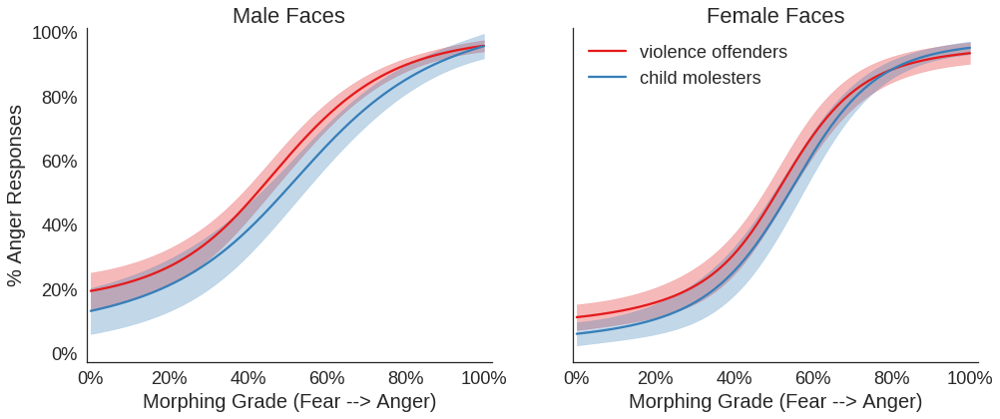

In [38]:
plotSmoothFuncs(logFuncDf,['G','K']);
#plt.savefig('../figures/fittedFuncViolenceChildM.png',dpi=300)

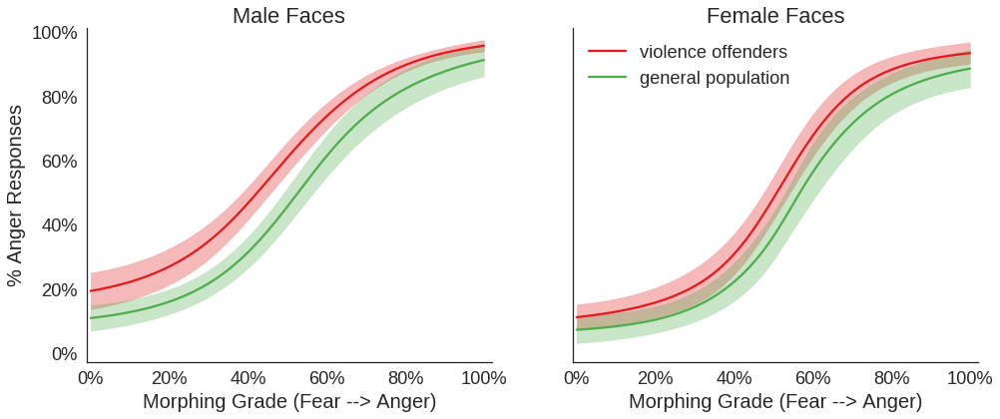

In [39]:
plotSmoothFuncs(logFuncDf,['G','A'])
#plt.savefig('../figures/fittedFuncViolenceGenPop.png',dpi=300)

### plot curve parameters

Get a new column indicating group membership

In [40]:
groupCol = []
for entry in paramsDf.index.levels[1]:
    try:
        paramsDf.ix[entry[0]].ix[entry]
        groupCol.append(labelCoding[entry[0]] )
    except:
        print entry # previously eliminated cases are excluded

A004
G002
G011
G013
G016
G025
K003
K004


In [41]:
paramsDf['group'] = groupCol

Table now has new column:

In [42]:
paramsDf.head()

F                                        M            \
           guess     lapse      slope threshold     guess     lapse   
A A001  0.106096  0.045968  30.023075  0.538619  0.060214 -0.032920   
  A002  0.128144  0.050533  11.404248  0.515501  0.141569 -0.056500   
  A003 -0.041611  0.187950   5.700279  0.485627 -0.037189 -0.202456   
  A005  0.262098 -0.017575  11.898831  0.471887  0.230314 -0.026271   
  A006  0.035116 -0.034113   5.780194  0.607114  0.249233  0.046546   

                            group  
            slope threshold        
A A001   8.437888  0.527474     2  
  A002   6.744358  0.556187     2  
  A003   5.246829  0.693392     2  
  A005  10.781355  0.476161     2  
  A006  10.672619  0.509249     2

### Plot the curve parameters

Only the threshold value:

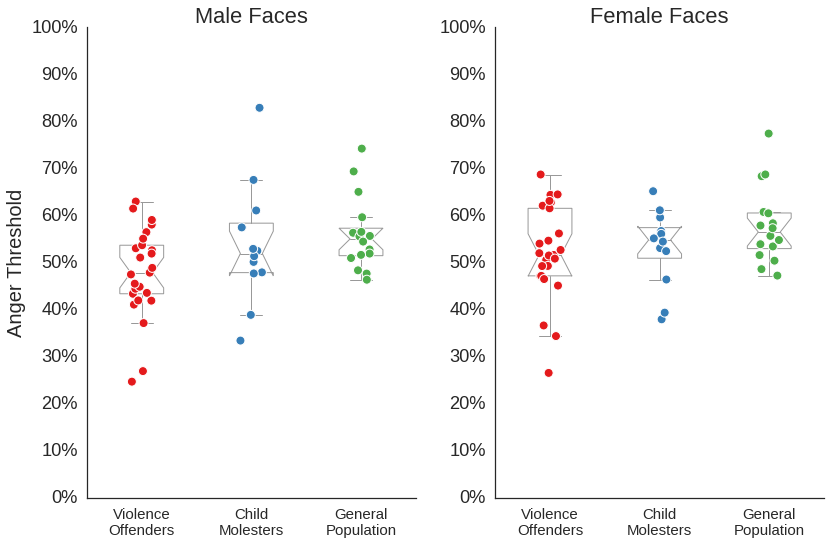

In [43]:
fig = plt.figure(figsize=(12,8))

for i,fGender in enumerate(['M','F']):
    ax = fig.add_subplot('12'+str(i+1))

    sns.boxplot(x='group',y=(fGender,'threshold'),data=paramsDf,
                width=0.4,linewidth=1,color='white',whis=True,notch=True,fliersize=0,ax=ax)
    sns.stripplot(x='group',y=(fGender,'threshold'),data=paramsDf,
                  jitter=True, edgecolor='white',palette=myPal,size=9,linewidth=1,ax=ax)
    
    if fGender == 'M':
        ax.set_title('Male Faces')
    else :
        ax.set_title('Female Faces')        
        
    ax.set_ylim(0,1)
    ax.set_xticklabels(['Violence\nOffenders','Child\nMolesters','General\nPopulation'],fontsize=15)
    ax.set_xlabel('')
    if i==0:
        ax.set_ylabel('Anger Threshold')
    else:
        ax.set_ylabel('')
    sns.despine()
    plt.yticks(np.arange(0,1.01,0.1), [str(a)+'%' for a in  np.arange(0,101,10)])

#plt.suptitle('Threshold of fitted function',fontsize=20, position=(0.51,1.1))
plt.tight_layout()
#plt.savefig('../figures/thresholdPic.png',dpi=300)
plt.show()

All curve parameters:

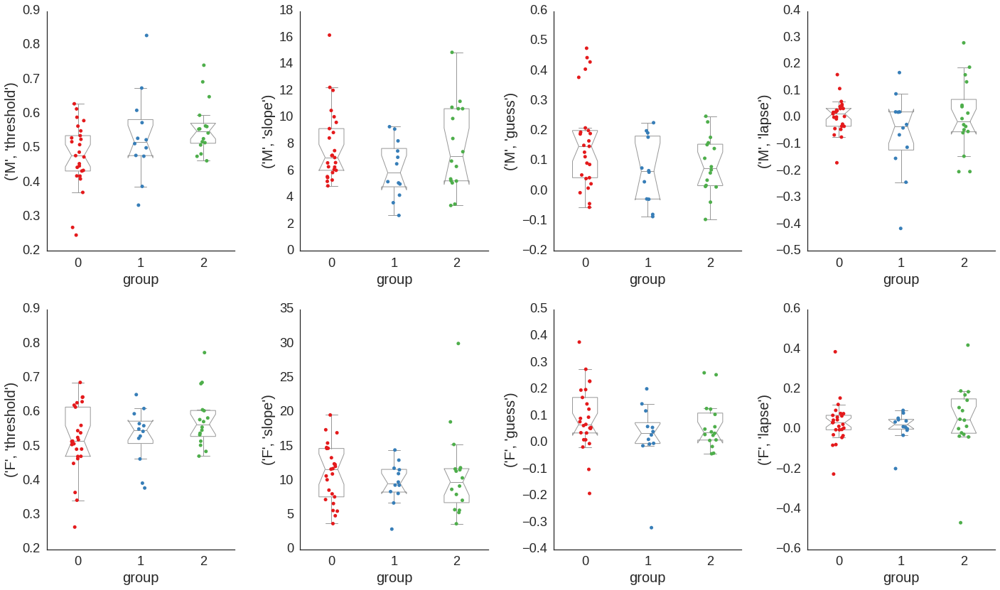

In [44]:
fig = plt.figure(figsize=(20,12))
i = 1
for fGender in ['M','F']:
    for param in ['threshold','slope','guess','lapse']:

        ax = fig.add_subplot(int('24'+str(i)))

        sns.boxplot(x='group',y=(fGender,param),data=paramsDf,
                        width=0.4,linewidth=1,color='white',whis=True,notch=True,fliersize=0,ax=ax)
        sns.stripplot(x='group',y=(fGender,param),data=paramsDf,
                          jitter=True, edgecolor='white',palette=myPal,ax=ax)
        sns.despine()
        
        i+= 1
plt.tight_layout()
plt.show()

### inferential statistics

In [45]:
def makeMannUTests(df):
    bigDf = pd.DataFrame()
    d = {}
    for comp in [('G','K'),('G','A'),('K','A')]:
        for variable in df.columns:
            group1 = df.ix[comp[0]][variable]
            group2 = df.ix[comp[1]][variable]
            U,p = stats.mannwhitneyu(group1,group2)
            if p<0.05:
                thisSig = '*'
            else:
                thisSig = 'n.s.'
            d[variable] = {'U':round(U,2),'p':round(p,3),'sig':thisSig}
        thisDf = pd.DataFrame(d)
        thisDf = thisDf.reindex_axis(['U','p','sig'], axis=0)
        thisDf.index = [ [comp[0]+' > '+comp[1]]*len(thisDf.index),thisDf.index ]

        bigDf = pd.concat([bigDf,thisDf])
    return bigDf.T

In [46]:
makeMannUTests(paramsDf['M'])

G > K              G > A              K > A             
              U      p   sig     U      p   sig     U      p   sig
guess       197  0.131  n.s.   252  0.169  n.s.    89  0.763  n.s.
lapse       193  0.168  n.s.   218   0.64  n.s.    78  0.417  n.s.
slope       206  0.072  n.s.   207  0.862  n.s.    64  0.144  n.s.
threshold   114  0.249  n.s.   104  0.011     *    79  0.444  n.s.

In [47]:
makeMannUTests(paramsDf['F'])

G > K              G > A              K > A             
              U      p   sig     U      p   sig     U      p   sig
guess       193  0.168  n.s.   244  0.245  n.s.    90  0.798  n.s.
lapse       157  0.833  n.s.   167  0.385  n.s.    76  0.365  n.s.
slope       179  0.355  n.s.   229  0.446  n.s.    98  0.944  n.s.
threshold   133  0.592  n.s.   137  0.095  n.s.    74  0.318  n.s.

## Correlate with AFAS

get the AFAS data, clean up and merge:

In [48]:
afasDf = pd.read_csv('../outputs/meanAFAS.csv',index_col=[0,1])

In [49]:
for elim in eliminated:
    afasDf.drop([elim],level=1, inplace=True)

In [50]:
assert ( afasDf.index == paramsDf.index ).all()

In [51]:
mergeDf = pd.DataFrame([ afasDf['Overall'], paramsDf['M']['threshold'], afasDf['group'] ]).T

(0, 4)

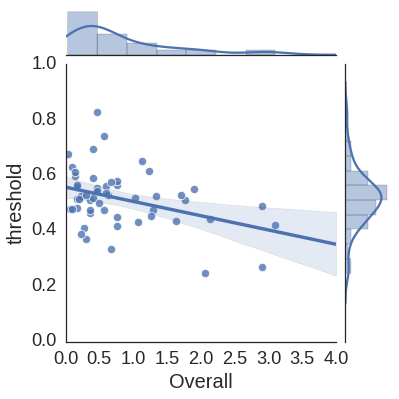

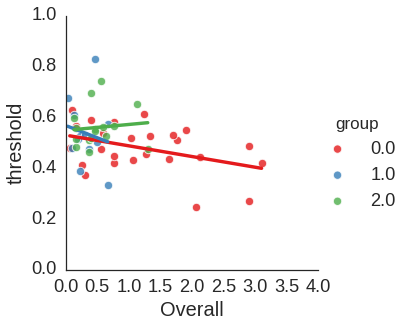

In [52]:
sns.jointplot("Overall", "threshold", data=mergeDf, kind="reg",
              xlim=(0, 4), ylim=(0, 1),stat_func=None,
              scatter_kws={"s": 70,"edgecolor":"white","linewidth":1}
             )

#plt.savefig('../figures/afasThreshCorrelationAll.png',dpi=300)


sns.lmplot(x="Overall", y="threshold", data=mergeDf,hue="group",ci=None,truncate=True,palette=myPal,
           scatter_kws={"s": 70,"edgecolor":"white","linewidth":1}
          )
plt.ylim(0,1);plt.xlim(0,4)
#plt.savefig('../figures/afasThreshCorrelationGroups.png',dpi=300)

In [53]:
r, p = stats.spearmanr(afasDf['Overall'], paramsDf['M']['threshold'])
print "r:",r,"p:",p

r: -0.271747990354 p: 0.049022490739


In [54]:
r, p = stats.pearsonr(afasDf['Overall'], paramsDf['M']['threshold'])
print "r:",r,"p:",p

r: -0.378826197719 p: 0.00515447315191


In [58]:
for scale in afasDf.columns[:-1]:
    print "\n",scale
    r, p = stats.spearmanr(afasDf[scale], paramsDf['M']['threshold'])
    print "Spearman r:",r,"p:",p
    r, p = stats.pearsonr(afasDf[scale], paramsDf['M']['threshold'])
    print "Pearson r:",r,"p:",p


Facilitative
Spearman r: -0.221010906663 p: 0.11175521498
Pearson r: -0.355250849129 p: 0.00904502534878

Appetitive
Spearman r: -0.295655082027 p: 0.0316041082614
Pearson r: -0.384477110938 p: 0.0044769476685

Overall
Spearman r: -0.271747990354 p: 0.049022490739
Pearson r: -0.378826197719 p: 0.00515447315191


### Export threshold parameters to JASP

In [55]:
jaspParams = paramsDf.copy(deep=True)
jaspParams.columns = jaspParams.columns.reorder_levels([1,0])
jaspParams = jaspParams['threshold'].copy(deep=True)

group = []
for x in jaspParams.index.levels[1]:
    try:
        jaspParams.ix[x[0]].ix[x]
        group.append(labelCoding[x[0]])
    except:
        print x

jaspParams['group'] = group

A004
G002
G011
G013
G016
G025
K003
K004


In [56]:
jaspParams.head()

F         M  group
A A001  0.538619  0.527474      2
  A002  0.515501  0.556187      2
  A003  0.485627  0.693392      2
  A005  0.471887  0.476161      2
  A006  0.607114  0.509249      2

In [57]:
jaspParams.to_csv('../outputs/thresholdJASP.csv')